In [1]:
import scanpy as sc
from pathlib import Path
import pandas as pd
import squidpy as sq
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# from muon import prot as pt
# from muon import MuData
# import muon as mu
import numpy as np
from jax.config import config
from itertools import product
from datetime import datetime

config.update("jax_enable_x64", True)
# config.update("jax_platform_name", "cpu")
# JAX_PLATFORM_NAME = "cpu"
%load_ext autoreload
%autoreload 1
%load_ext lab_black

path_data = Path("/lustre/groups/ml01/workspace/moscot_paper/mapping")

In [2]:
scaler = StandardScaler()

adata_sc = sc.read(path_data / "adata_sc_processed.h5ad")
adata_p = sc.read(path_data / "adata_cite_processed.h5ad")
sc.pp.pca(adata_p, n_comps=30)
adata_sc.obsm["X_pca_protein"] = adata_p.obsm["X_pca"].copy()
adata_sc.obsm["X_pca_protein_scaled"] = scaler.fit_transform(
    adata_p.obsm["X_pca"].copy()
)
# sc.pp.subsample(adata_sc, fraction=0.5)

In [3]:
adata_spatial = sc.read(path_data / "vizgen_liver/adata_result.h5ad")
adata_spatial.X = adata_spatial.layers["normalized"].copy()
sc.pp.pca(adata_spatial, n_comps=30)
adata_spatial.obsm["spatial_scaled"] = scaler.fit_transform(
    adata_spatial.obsm["spatial"]
)
adata_spatial.obsm["X_pca_scaled"] = scaler.fit_transform(adata_spatial.obsm["X_pca"])
adata_spatial.obsm["X_pca_spatial_scaled"] = np.concatenate(
    [adata_spatial.obsm["X_pca_scaled"], adata_spatial.obsm["spatial_scaled"]], axis=1
)

In [4]:
# sc.pp.subsample(adata_sc, fraction=0.01)
# sc.pp.subsample(adata_spatial, fraction=0.01)

In [5]:
# print(
#     np.max(adata_spatial.obsm["X_pca_scaled"]),
#     np.max(adata_spatial.obsm["spatial_scaled"]),
#     np.max(adata_spatial.obsm["X_pca_spatial_scaled"]),
#     np.max(adata_sc.obsm["X_pca_protein_scaled"]),
# )

In [6]:
# print(
#     np.var(adata_spatial.obsm["X_pca_scaled"]),
#     np.var(adata_spatial.obsm["spatial_scaled"]),
#     np.var(adata_spatial.obsm["X_pca_spatial_scaled"]),
#     np.var(adata_sc.obsm["X_pca_protein_scaled"]),
# )

In [7]:
import mplscience
import matplotlib.pyplot as plt

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams["legend.scatterpoints"] = 1

['default', 'despine']


In [8]:
# # sc.set_figure_params(figsize=(3, 3), dpi=100)
# sq.pl.spatial_scatter(adata_spatial, shape=None, color="Cell_Type", figsize=(10, 10))

In [9]:
adata_spatial.var_names = [v.capitalize() for v in adata_spatial.var_names.values]

In [10]:
var_names = list(
    set(adata_sc.var_names.values).intersection(adata_spatial.var_names.values)
)
len(var_names)

336

/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


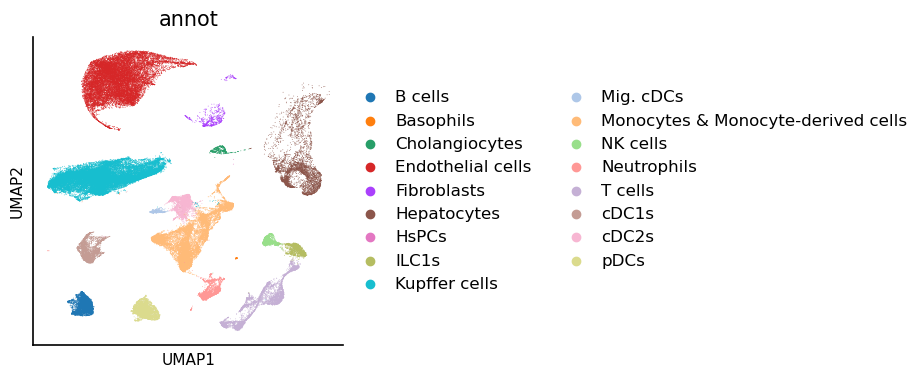

<Figure size 400x400 with 0 Axes>

In [11]:
sc.pl.umap(
    adata_sc,
    color=[
        # "n_counts",
        "annot",
    ],
)
plt.tight_layout()

/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


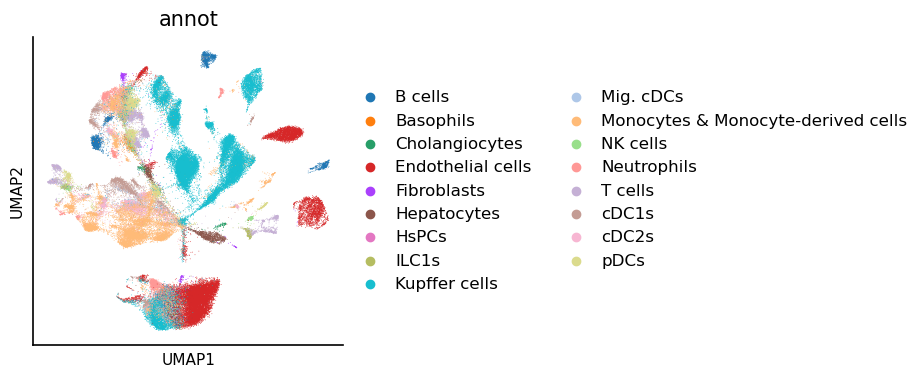

<Figure size 400x400 with 0 Axes>

In [12]:
sc.pl.umap(
    adata_p,
    color=["annot"],
)
plt.tight_layout()

In [13]:
from moscot.problems.space import MappingProblem

problem = (
    MappingProblem(adata_sc, adata_spatial).prepare(
        # batch_key="batch",
        sc_attr={"attr": "obsm", "key": "X_pca_protein_scaled"},
        spatial_key={"attr": "obsm", "key": "X_pca_spatial_scaled"},
        # normalize=True,
        var_names=var_names,
    )
    # .solve(alpha=0.5, epsilon=1e-2)
)
# joint_attr={
#     "x_attr": "obsm",
#     "x_key": "X_scanorama",
#     "y_attr": "obsm",
#     "y_key": "X_scanorama",
# },

/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/flax/core/frozen_dict.py:169: FutureWarning: jax.tree_util.register_keypaths is deprecated, and will be removed in a future release. Please use `register_pytree_with_keys()` instead.
  jax.tree_util.register_keypaths(
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/docrep/decorators.py:43: SyntaxWarning: 'interpolation_parameters' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/docrep/decorators.py:43: SyntaxWarning: 'account_for_unbalancedness' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/python3.9/site-packages/docrep/decorators.py:43: SyntaxWarning: 'batch_size' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/home/icb/giovanni.palla/miniconda3/envs/moscot2/lib/p

INFO     Computing pca with `n_comps=30` for `xy` using `adata.X`                                                  


In [14]:
from datetime import datetime

start_time = datetime.now()
problem = problem.solve(
    alpha=0.2,
    rank=500,
    max_iterations=100,
    threshold=1e-7,
)
end_time = datetime.now()

INFO     Solving problem OTProblem[stage='prepared', shape=(367235, 91040)].                                       
WARNING  Solver did not converge                                                                                   


In [15]:
print(end_time - start_time)

1:39:30.632163


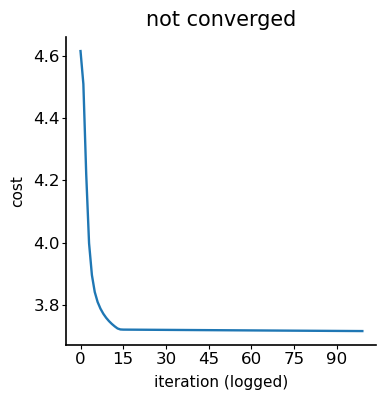

In [16]:
problem.problems[("src", "tgt")].solution.plot_costs()

In [17]:
problem.save(path_data / "output", overwrite=True)

INFO     Successfully saved the problem as                                                                         
         `/lustre/groups/ml01/workspace/moscot_paper/mapping/output/MappingProblem.pkl`                            


In [18]:
from anndata import AnnData

prot = adata_p[adata_sc.obs_names].X.A
spatial_prot = problem.problems[("src", "tgt")].solution.pull(
    prot,
    scale_by_marginals=True,
)
adata_spatial_prot = AnnData(
    np.array(spatial_prot), obs=adata_spatial.obs.copy(), obsm=adata_spatial.obsm.copy()
)
adata_spatial_prot.var_names = adata_p.var_names.copy()

/tmp/ipykernel_378478/129798072.py:8: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_spatial_prot = AnnData(


In [19]:
adata_spatial_prot.X.max()

0.93947506

In [20]:
adata_spatial_prot.obs["Cell_Type"] = adata_spatial.obs["Cell_Type"].copy()

In [21]:
dummy = pd.get_dummies(adata_sc.obs["annot"])

In [22]:
temp = problem[("src", "tgt")].pull(dummy, scale_by_marginals=False)
temp.shape

(367235, 17)

In [23]:
clusters = pd.Categorical([dummy.columns[i] for i in np.array(temp.argmax(1))])
clusters.value_counts()

B cells                                3307
Basophils                             13384
Endothelial cells                     69627
Fibroblasts                            7831
Hepatocytes                           52186
HsPCs                                 35301
ILC1s                                  4633
Kupffer cells                         84982
Mig. cDCs                             17548
Monocytes & Monocyte-derived cells    34670
NK cells                              14767
Neutrophils                            3297
T cells                                4740
cDC1s                                 15576
cDC2s                                   330
pDCs                                   5056
dtype: int64

In [24]:
adata_spatial_prot.obs["celltype_mapped"] = clusters

In [25]:
adata_spatial_prot.obs["celltype_mapped"].cat.categories

Index(['B cells', 'Basophils', 'Endothelial cells', 'Fibroblasts',
       'Hepatocytes', 'HsPCs', 'ILC1s', 'Kupffer cells', 'Mig. cDCs',
       'Monocytes & Monocyte-derived cells', 'NK cells', 'Neutrophils',
       'T cells', 'cDC1s', 'cDC2s', 'pDCs'],
      dtype='object')

In [26]:
adata_sc.obs["annot"].cat.categories

Index(['B cells', 'Basophils', 'Cholangiocytes', 'Endothelial cells',
       'Fibroblasts', 'Hepatocytes', 'HsPCs', 'ILC1s', 'Kupffer cells',
       'Mig. cDCs', 'Monocytes & Monocyte-derived cells', 'NK cells',
       'Neutrophils', 'T cells', 'cDC1s', 'cDC2s', 'pDCs'],
      dtype='object')

In [27]:
adata_spatial_prot.uns["celltype_mapped_colors"] = adata_sc.uns["annot_colors"].copy()

In [28]:
adata_spatial_prot.obs["celltype_mapped"].unique()

['NK cells', 'Kupffer cells', 'HsPCs', 'cDC1s', 'Basophils', ..., 'B cells', 'pDCs', 'Fibroblasts', 'Neutrophils', 'cDC2s']
Length: 16
Categories (16, object): ['B cells', 'Basophils', 'Endothelial cells', 'Fibroblasts', ..., 'T cells', 'cDC1s', 'cDC2s', 'pDCs']

In [29]:
adata_spatial_prot.uns.pop("celltype_mapped_colors")

array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a',
       '#ff9896', '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'],
      dtype=object)

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


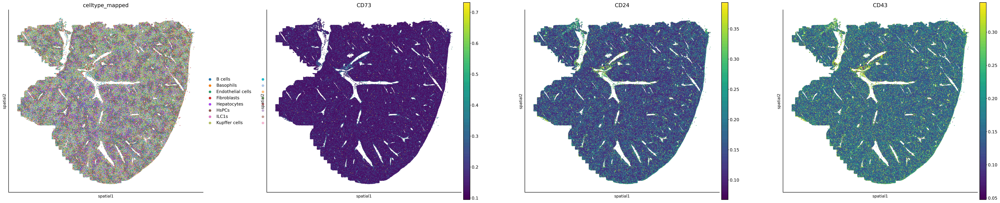

In [30]:
sq.pl.spatial_scatter(
    adata_spatial_prot,
    shape=None,
    color=["celltype_mapped", "CD73", "CD24", "CD43"],
    # groups="Neutrophils",
    size=1,
    figsize=(10, 10),
    dpi=300,
)

In [ ]:
df = problem.cell_transition(
    source="src",
    target="tgt",
    source_groups="leiden",
    target_groups="annot",
    forward=True,
    aggregation_mode="cell",
    batch_size=1024,
)

In [33]:
df.shape

(367235, 17)

In [34]:
adata_spatial_prot.shape

(367235, 103)

In [35]:
df.to_csv(path_data / "cell_transition_score.csv.gz")

In [40]:
adata_sc.uns

OverloadedDict, wrapping:
	{'annot_colors': array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a',
       '#ff9896', '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'],
      dtype=object), 'hvg': {'flavor': 'seurat_v3'}, 'pca': {'params': {'use_highly_variable': True, 'zero_center': True}, 'variance': array([68.83061655, 40.93930623, 35.82767001, 12.02791661,  9.96524978,
        7.15649062,  5.71358189,  4.87510916,  3.88539973,  3.42104002,
        2.6509935 ,  2.31554866,  2.10380819,  1.77940052,  1.67233874,
        1.58186756,  1.49814485,  1.3219344 ,  1.17682806,  1.16440035,
        1.09813703,  1.05418686,  0.96197904,  0.90753147,  0.81489715,
        0.77794827,  0.77209844,  0.70698169,  0.69856287,  0.66040353,
        0.63352253,  0.60146004,  0.59503431,  0.57737768,  0.56476899,
        0.54519088,  0.52524549,  0.51749469,  0.50809196,  0.4940402 ,
        0.47719955,  0.46073588,  0.

In [43]:
adata_spatial_prot.write(path_data / "adata_spatial_protein_out.h5ad")

adata_sc.write(path_data / "adata_sc_out.h5ad")

In [49]:
# adata_spatial.uns.pop("moscot_results")

In [50]:
adata_spatial.write(path_data / "adata_spatial_out.h5ad")

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


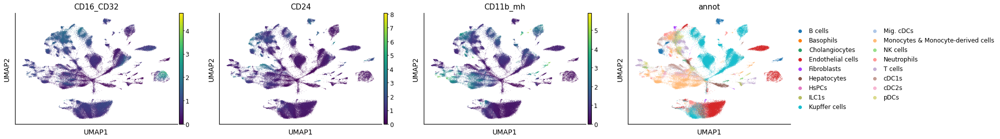

<Figure size 432x288 with 0 Axes>

In [30]:
sc.pl.umap(
    adata_p,
    color=["CD16_CD32", "CD24", "CD11b_mh", "annot"],
)
plt.tight_layout()

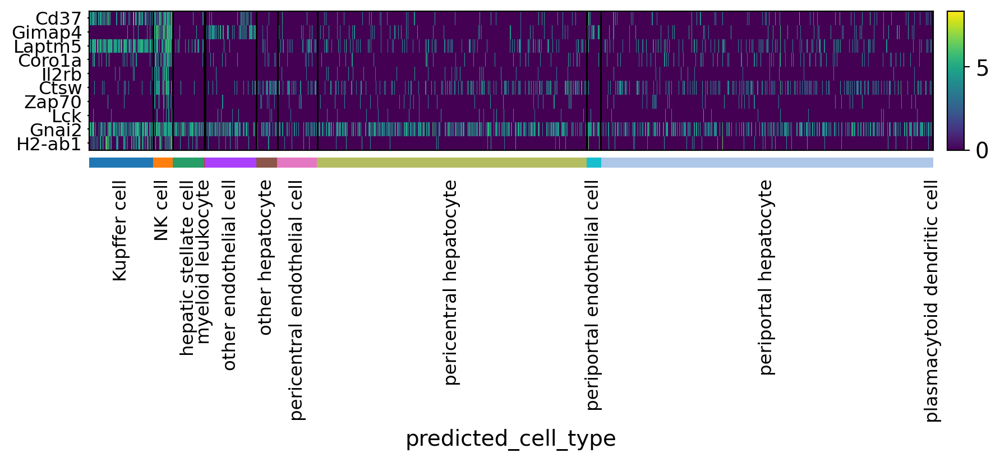

In [46]:
sc.pl.heatmap(
    adata_spatial,
    df_genes.names.values,
    groupby="predicted_cell_type",
    swap_axes=True,
)

Results with standard scaling

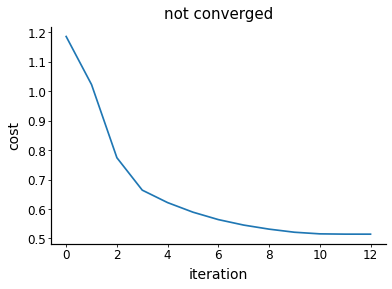

In [46]:
problem[("src", "tgt")].solution.plot_convergence()

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


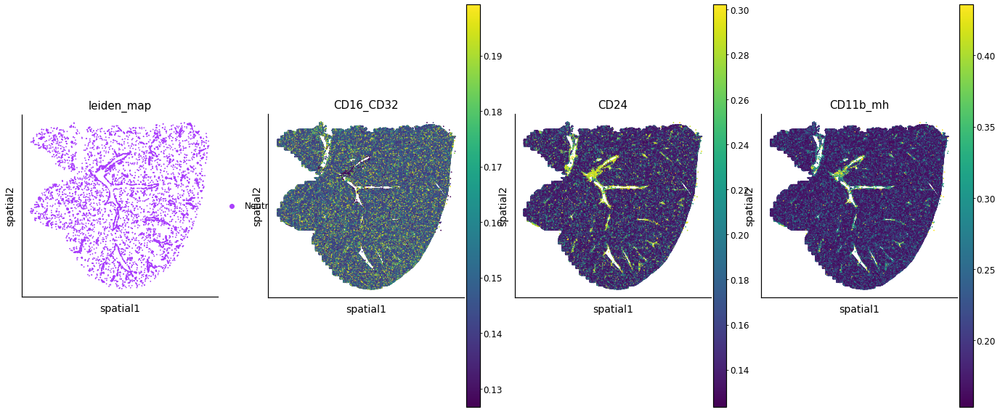

In [60]:
sq.pl.spatial_scatter(
    adata_spatial_prot,
    shape=None,
    color=["leiden_map", "CD16_CD32", "CD24", "CD11b_mh"],
    groups="Neutrophil",
    size=1,
    figsize=(5, 10),
)